**Predictions on external data**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# feature extractoring and preprocessing data
import librosa
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
from PIL import Image
import pathlib
import csv

# Preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.externals import joblib

#Keras
import keras

import warnings
warnings.filterwarnings('ignore')

Using TensorFlow backend.


In [3]:
cd /content/drive/My\ Drive

/content/drive/My Drive


In [4]:
# Loading our Model

model = keras.models.load_model('music_classifier.h5')

# Loading our Scaler

scaler = joblib.load('scaler.save')
encoder = joblib.load('encoder.save')

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.


In [0]:
def extract_features(songname):
    
    # Extract Features
    y, sr = librosa.load(songname, mono=True, duration=30)
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    rmse = librosa.feature.rmse(y=y)
    
    # Append to a list
    feature_list = f'{np.mean(chroma_stft)} {np.mean(rmse)} {np.mean(spec_cent)} {np.mean(spec_bw)} {np.mean(rolloff)} {np.mean(zcr)}'
    for e in mfcc:
        feature_list += f' {np.mean(e)}'
    
    # Convert to a numpy array
    feature_array = np.array(list(map(float, feature_list.split(' '))))
    
    # Reshaping the array to a column vector
    feature_array = feature_array.reshape((1,26))
    feature_array = scaler.transform(feature_array)
    return feature_array

def predict_song(songname):
    feature_array = extract_features(songname)
    predicted_label = model.predict_classes(feature_array)
    predicted_class = encoder.inverse_transform(predicted_label)
    return predicted_class

In [6]:
# Loading the song

from IPython.display import Audio
Audio(filename="Ice Cube - Do Ya Thang (Dirty).mp3")

In [16]:
# Predicting the results

predict_song('Ice Cube - Do Ya Thang (Dirty).mp3')


array(['Hiphop'], dtype=object)

In [14]:
from IPython.display import Audio
Audio(filename="Bob Marley Jammin.mp3")

In [15]:
# Predicting the results

predict_song('Bob Marley Jammin.mp3')

array(['Reggae'], dtype=object)

In [0]:
def get_bpm(songname):
    x, sr = librosa.load(songname)
    tempo, beat_times = librosa.beat.beat_track(x, sr=sr)
    return ("%.2f" % tempo)

In [20]:
pip install google_images_download

     |████████████████████████████████| 911kB 10.4MB/s 
  Stored in directory: /root/.cache/pip/wheels/50/69/5e/1e8ff181c23898e327167a149741bda663efb366b58d61d233
Successfully built google-images-download


In [0]:
from google_images_download import google_images_download

def download_image(artist_name):
    response = google_images_download.googleimagesdownload()
    arguments = {"keywords":artist_name,"limit":1,"print_urls":True}
    paths = response.download(arguments)
    return paths

In [0]:
# from ArcCloud.acrcloud.recognizer import ACRCloudRecognizer, ACRCloudRecognizeType

# def get_song_info(songname):
#     # configure the api
#     config = {
#         'host':'identify-ap-southeast-1.acrcloud.com',
#         'access_key':'a60eaf89e7a5977686ad563c6d29682b',
#         'access_secret':'7uwt74A9AiJ8dx0Yz8Yp79khegLFHACppDbDsznL',
#         'recognize_type': ACRCloudRecognizeType.ACR_OPT_REC_AUDIO,
#         'debug':False,
#         'timeout':10 # seconds
#     }

#     # Instantiate Recognizer
#     re = ACRCloudRecognizer(config)
#     json_data = re.recognize_by_file(songname, 0, 10)

#     return json_data

In [23]:
get_bpm('Bob Marley Jammin.mp3')

'123.05'

In [14]:
download_image('Bob marley')
from IPython.display import Image
Image('downloads/Bob marley/1.bob-marley-legend-the-best-of-delantera-400x400.jpg')


Item no.: 1 --> Item name = Bob marley
Evaluating...
Starting Download...
Image URL: http://www.bobmarley.com/wp-content/uploads/2013/10/bob-marley-legend-the-best-of-delantera-400x400.jpg
Completed Image ====> 1.bob-marley-legend-the-best-of-delantera-400x400.jpg

Errors: 0



({'Bob marley': ['/content/drive/My Drive/downloads/Bob marley/1.bob-marley-legend-the-best-of-delantera-400x400.jpg']},
 0)

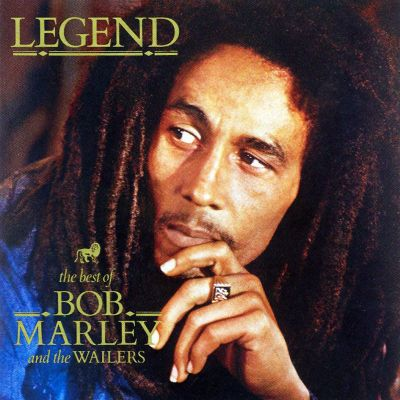

In [23]:
from IPython.display import Image
Image('downloads/Bob marley/1.bob-marley-legend-the-best-of-delantera-400x400.jpg')